In [1]:
from PIL import Image
from PIL.ImageFilter import GaussianBlur
import random
import numpy as np
import matplotlib.pyplot as plt

In [2]:
BaseImage = Image.open("./Base.jpeg")

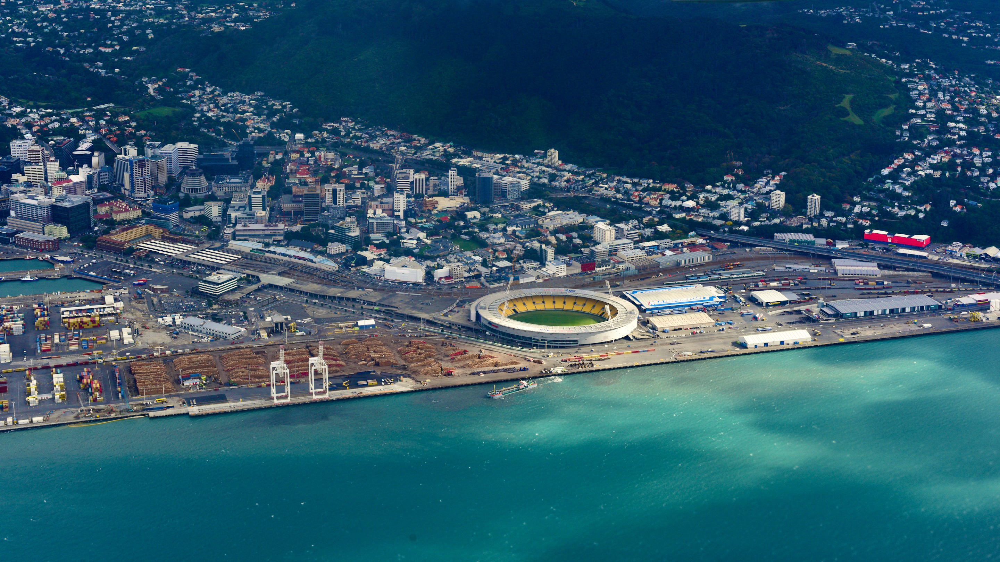

In [3]:
BaseImage

In [4]:
BaseImageArr = np.array(BaseImage)
(ImY, ImX, RGB) =BaseImageArr.shape

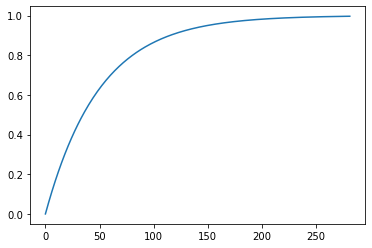

In [14]:
# User Config

Points = 7000 # Number of Stars

ImCoverage = 0. # Number of Stars relative to image 

if ImCoverage != 0:
    Points = int(ImCoverage * ImY * ImX)
    
Angle = 47 # Degrees
ResolU = 6 # Per Degree

Centre = np.array([1240, 965])

Debug = False

BlendBefore = 0.1 # Alpha of original Image

TailStrength = 0.02 # Exponential Interpolation, Brightness I / Brightness F = exp(- TailStrength * Time)

Resol = int(np.abs(ResolU * Angle))
ResolArr = np.arange(Resol)
plt.plot(ResolArr, (1 - np.exp(-TailStrength * ResolArr)))

In [15]:
ListX = np.random.randint(0, ImX, (Points))
ListY = np.random.randint(0, ImY, (Points))

ListXY = np.vstack([ListX,ListY]).T

ColorArr = np.zeros([Points, 3])

for i in range(Points):
    ColorArr[i,:] = BaseImageArr[ListY[i],ListX[i],:]

(1621.0, 0.0)

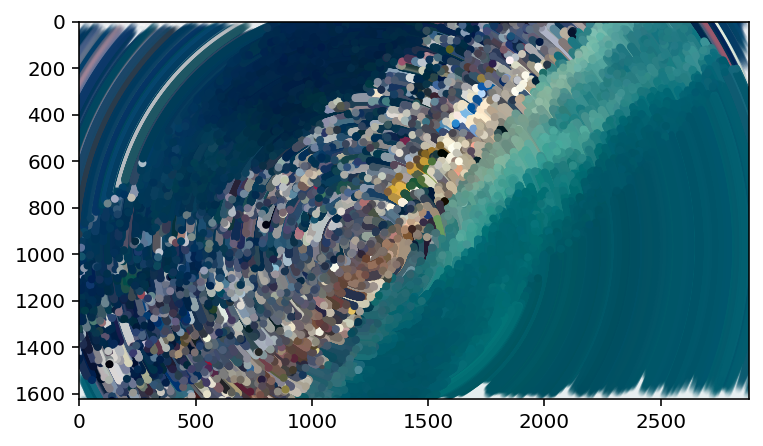

In [16]:
# Sketch 1: Matplotlib

fig = plt.figure(dpi=144)

plt.imshow(BaseImageArr, alpha=BlendBefore)

ListXYO = ListXY - Centre

if Debug:
    plt.scatter(ListXY[:, 0], ListXY[:, 1], color='blue')
    plt.scatter(Centre[0], Centre[1], color='red')

# Internal Cogs

AngleStep = Angle / Resol / 180 * np.pi

RotMatrix = np.array([[np.cos(AngleStep), -np.sin(AngleStep)],
                      [np.sin(AngleStep), np.cos(AngleStep)]])

for i in range(Resol):

    ListXYO = np.dot(ListXYO, RotMatrix)

    LocalXY = ListXYO + Centre

    plt.scatter(LocalXY[:, 0],
                LocalXY[:, 1],
                color=(ColorArr/255).tolist(),
                alpha = 1 - np.exp(-TailStrength * i),
                marker='.')

plt.xlim(0, ImX)
plt.ylim(ImY, 0)

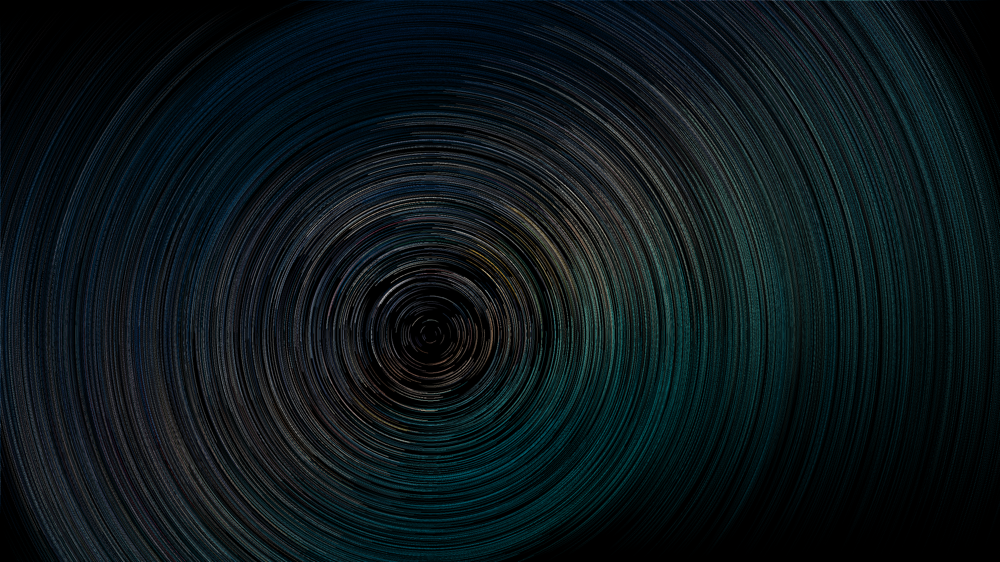

In [17]:
# Sketch 2: PIL

NewImage = np.zeros((ImY, ImX, 3))

ListXYO = ListXY - Centre

# Internal Cogs

AngleStep = Angle / Resol / 180 * np.pi

RotMatrix = np.array([[np.cos(AngleStep), -np.sin(AngleStep)],
                      [np.sin(AngleStep), np.cos(AngleStep)]])

for i in range(Resol):

    ListXYO = np.dot(ListXYO, RotMatrix)

    LocalXY = (ListXYO + Centre).astype(int)
    
    LocalXY[(LocalXY < 0)] = 0
    
    for j in range(Points):
        try:
        
            NewImage[LocalXY[j,1],LocalXY[j,0],:] = (ColorArr[j]) * (1 - np.exp(-TailStrength * i))
            
        except:
            continue
            
OutImage = Image.fromarray(NewImage.astype("uint8"))
OutImage

In [18]:
OutImage = OutImage.filter(GaussianBlur(1))

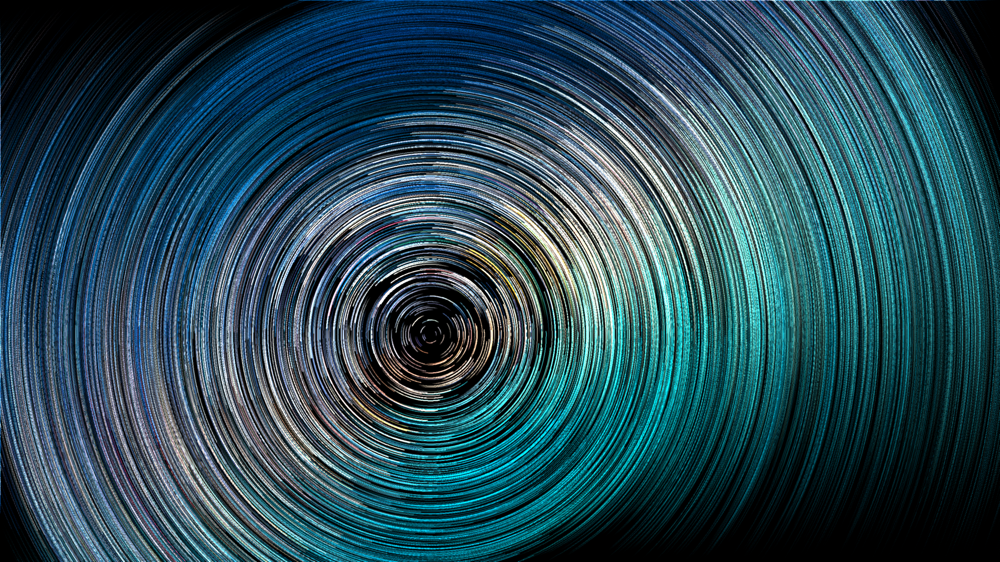

In [19]:
from PIL import ImageEnhance
enhancer = ImageEnhance.Brightness(OutImage)
FinalImage = enhancer.enhance(3.5)

FinalImage